#Dog Vision with Tensorflow

### Enabling and testing the GPU


In [ ]:
import tensorflow as tf
import tensorflow_hub as hub
import os
import pandas as pd
print("TF version:", tf.__version__)
print("Hub version:", hub.__version__)

TF version: 2.12.0
Hub version: 0.13.0


In [ ]:
print("GPU", "available" if tf.config.list_physical_devices("GPU") else "not available :(")

GPU available


### Accessing the data

In [ ]:
labels_csv = pd.read_csv("drive/My Drive/Dog-vision/labels.csv")
print(labels_csv.describe())
print(labels_csv.head())

                                      id               breed
count                              10222               10222
unique                             10222                 120
top     000bec180eb18c7604dcecc8fe0dba07  scottish_deerhound
freq                                   1                 126
                                 id             breed
0  000bec180eb18c7604dcecc8fe0dba07       boston_bull
1  001513dfcb2ffafc82cccf4d8bbaba97             dingo
2  001cdf01b096e06d78e9e5112d419397          pekinese
3  00214f311d5d2247d5dfe4fe24b2303d          bluetick
4  0021f9ceb3235effd7fcde7f7538ed62  golden_retriever


In [ ]:
labels_csv.head()

,id,breed
0,000bec180eb18c7604dcecc8fe0dba07,boston_bull
1,001513dfcb2ffafc82cccf4d8bbaba97,dingo
2,001cdf01b096e06d78e9e5112d419397,pekinese
3,00214f311d5d2247d5dfe4fe24b2303d,bluetick
4,0021f9ceb3235effd7fcde7f7538ed62,golden_retriever


###Visualize labels

<Axes: >

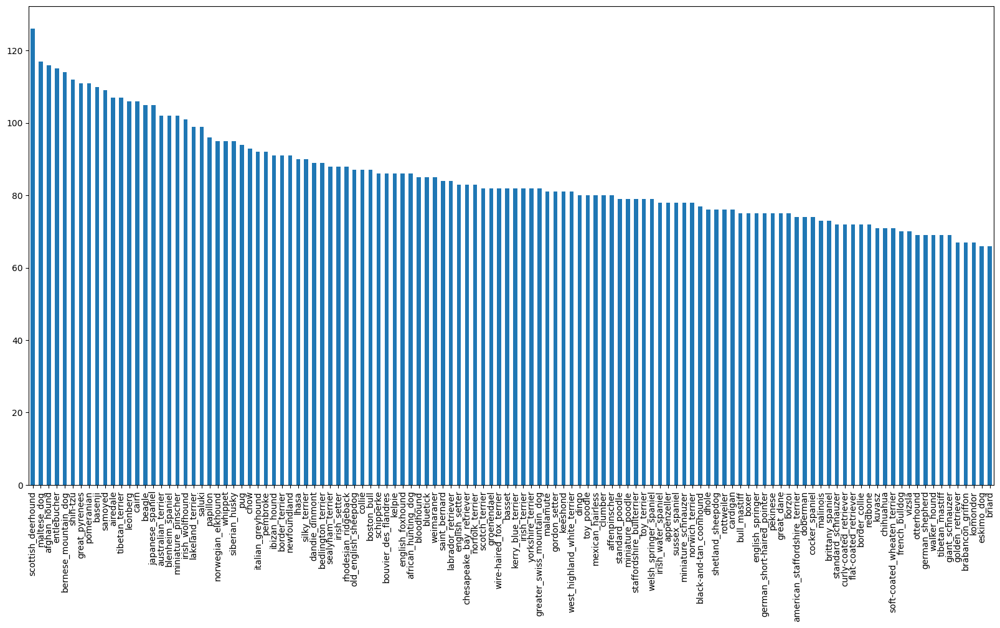

In [ ]:
labels_csv["breed"].value_counts().plot.bar(figsize=(20, 10))

###View image

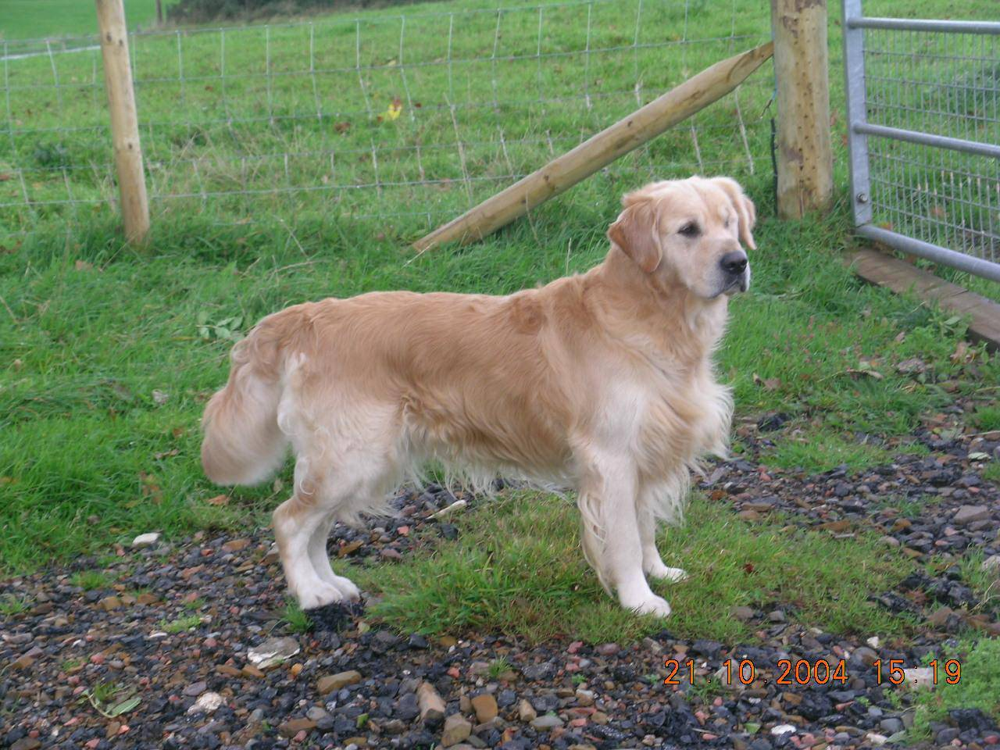

In [ ]:
from IPython.display import Image
Image("drive/My Drive/Dog-vision/train/febcab8eb2da444bf83336cffec7eb92.jpg")


In [ ]:
filenames = ["drive/My Drive/Dog-vision/train/" + fname + ".jpg" for fname in labels_csv["id"]]
filenames[:10]

['drive/My Drive/Dog-vision/train/000bec180eb18c7604dcecc8fe0dba07.jpg',
 'drive/My Drive/Dog-vision/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg',
 'drive/My Drive/Dog-vision/train/001cdf01b096e06d78e9e5112d419397.jpg',
 'drive/My Drive/Dog-vision/train/00214f311d5d2247d5dfe4fe24b2303d.jpg',
 'drive/My Drive/Dog-vision/train/0021f9ceb3235effd7fcde7f7538ed62.jpg',
 'drive/My Drive/Dog-vision/train/002211c81b498ef88e1b40b9abf84e1d.jpg',
 'drive/My Drive/Dog-vision/train/00290d3e1fdd27226ba27a8ce248ce85.jpg',
 'drive/My Drive/Dog-vision/train/002a283a315af96eaea0e28e7163b21b.jpg',
 'drive/My Drive/Dog-vision/train/003df8b8a8b05244b1d920bb6cf451f9.jpg',
 'drive/My Drive/Dog-vision/train/0042188c895a2f14ef64a918ed9c7b64.jpg']

In [ ]:
# Check whether number of filenames matches number of actual image files
# If everything worked, we should see a match up.
if len(os.listdir("drive/My Drive/Dog-vision/train/")) == len(filenames):
  print("Filenames match actual amount of files.")
else:
  print("Filenames do no match actual amount of files, check the target directory.")


Filenames match actual amount of files.


 If everything worked, we should see a match up.

Let's do one more check. Visualizing directly from a filepath.




In [ ]:
labels_csv["breed"][9000]

'tibetan_mastiff'

In [ ]:
import numpy as np
labels = labels_csv["breed"].to_numpy() 
#labels = np.array(labels) # does same thing as above
labels

array(['boston_bull', 'dingo', 'pekinese', ..., 'airedale',
       'miniature_pinscher', 'chesapeake_bay_retriever'], dtype=object)

In [ ]:
# See if number of labels matches the number of filenames
if len(labels) == len(filenames):
  print("Number of labels matches number of filenames!")
else:
  print("Number of labels does not match number of filenames, check data directories!")

Number of labels matches number of filenames!


In [ ]:
# Find the unique label values
unique_breeds = np.unique(labels)
len(unique_breeds)

120

In [ ]:
boolean_labels = [label == unique_breeds for label in labels]
boolean_labels[:2]

[array([False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False,  True, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False]),
 array([False, False, False, False, False, Fal

In [ ]:
len(boolean_labels)

10222

### Creating our own validation set
Let's split test dataset to check model success

In [ ]:
X = filenames
y = boolean_labels

In [ ]:
NUM_IMAGES = 1000 #@param {type:"slider", min:1000, max:10000, step:1000}

In [ ]:
from sklearn.model_selection import train_test_split

# Split them into training and validation of total size NUM_IMAGES
X_train, X_val, y_train, y_val = train_test_split(X[:NUM_IMAGES],
                                                  y[:NUM_IMAGES],
                                                  test_size=0.2,
                                                  random_state=42)

len(X_train), len(y_train), len(X_val), len(y_val)

(800, 800, 200, 200)

##Turning images into Tensors

Because of how TensorFlow stores information (in Tensors), it allows machine learning and deep learning models to be run on GPUs (generally faster at numerical computing).

In [ ]:
from matplotlib.pyplot import imread
image = imread(filenames[42])
image.shape

(257, 350, 3)

In [ ]:
# turn image into a tensor
tf.constant(image)[:2]

<tf.Tensor: shape=(2, 350, 3), dtype=uint8, numpy=
array([[[ 89, 137,  87],
        [ 76, 124,  74],
        [ 63, 111,  59],
        ...,
        [ 76, 134,  86],
        [ 76, 134,  86],
        [ 76, 134,  86]],

       [[ 72, 119,  73],
        [ 67, 114,  68],
        [ 63, 111,  63],
        ...,
        [ 75, 131,  84],
        [ 74, 132,  84],
        [ 74, 131,  86]]], dtype=uint8)>

In [ ]:
IMG_SIZE = 224 # for pretrained model resoliton

# Create a function for preprocessing images
def process_image(image_path, img_size=IMG_SIZE):
  """
  Takes an image file path and turns the image into a Tensor.
  """
  image = tf.io.read_file(image_path) #tfrecords
  # Turn the jpeg image into numerical Tensor with 3 colour channels (Red, Green, Blue)
  image = tf.image.decode_jpeg(image, channels=3)
  # Convert the colour channel values from 0-255 to 0-1 values (Normalization)
  # More effficient for calculation 
  image = tf.image.convert_image_dtype(image, tf.float32)
  # Resize the image to our desired value (224, 224)
  image = tf.image.resize(image, size=[IMG_SIZE, IMG_SIZE])

  return image

In [ ]:
def get_image_and_label(image_path, label):
  """
  Takes an images file path and label, processes the image and 
  returns a tuple of image,label
  """
  image = process_image(image_path)
  return image, label

#funtion demo
(process_image(X[1]), tf.constant(y[42]))

(<tf.Tensor: shape=(224, 224, 3), dtype=float32, numpy=
 array([[[0.22176053, 0.1532646 , 0.12077089],
         [0.24290617, 0.17007563, 0.12532842],
         [0.25025794, 0.16272292, 0.10750583],
         ...,
         [0.4866906 , 0.31810698, 0.18481737],
         [0.46775866, 0.32910115, 0.20204483],
         [0.36027768, 0.2283099 , 0.11981372]],
 
        [[0.22331059, 0.14479166, 0.10454448],
         [0.20956516, 0.13433544, 0.08120592],
         [0.20576334, 0.11818807, 0.06297097],
         ...,
         [0.34747207, 0.21052358, 0.10098223],
         [0.25428382, 0.14531395, 0.05989731],
         [0.22268865, 0.11715643, 0.03506609]],
 
        [[0.21673436, 0.12777252, 0.0741048 ],
         [0.20701681, 0.11805496, 0.05878148],
         [0.22288738, 0.12433178, 0.0666433 ],
         ...,
         [0.19956292, 0.10319562, 0.05528758],
         [0.24323113, 0.17113218, 0.12510629],
         [0.17322923, 0.11525137, 0.08183777]],
 
        ...,
 
        [[0.71888185, 0.40606675

In [ ]:
BATCH_SIZE = 32

def create_data_batches(x, y=None, batch_size = BATCH_SIZE, valid_data= False, test_data = False):
  """
  Creates batches of data
  image(X) and label(y)
  Shuffles data  if it is training data
  Accept test data as input with no labels

  """

  if test_data:
    print("Creating test batches..")
    data = tf.data.Dataset.from_tensor_slices(tf.constant(x)) # only filepaths (no labels)
    data_batch = data.map(process_image).batch(BATCH_SIZE)
    return data_batch

  elif valid_data:
    print("Creating valid batches..")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x),
                                               tf.constant(y)))
    data_batch = data.map(get_image_and_label).batch(BATCH_SIZE)
    return data_batch

  else: 
    print("Creating train batches..")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x), tf.constant(y)))
    data = data.shuffle(buffer_size = len(x))
    data_batch = data.map(get_image_and_label).batch(BATCH_SIZE) 
    return data_batch

In [ ]:
train_data = create_data_batches(X_train, y_train)
valid_data = create_data_batches(X_val, y_val, valid_data=True)

Creating train batches..
Creating valid batches..


In [ ]:
train_data.element_spec, valid_data.element_spec

((TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)),
 (TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)))

## Visualizing Data Batches

In [ ]:
import matplotlib.pyplot as plt

def show_images(images, labels):
  """
  Display a plot of images and their labels from a data batch
  """
  plt.figure(figsize=(10,10))
  image_num = 9                                #@param {type:"slider", min:1, max:50, step:1}
  for i in range(image_num):
    ax = plt.subplot(3, 3, i+1)
    plt.imshow(images[i])
    plt.title(unique_breeds[labels[i].argmax()])
    plt.axis("off")



In [ ]:
train_images, train_labels = next(train_data.as_numpy_iterator())
train_images, train_labels

(array([[[[0.3163693 , 0.2653889 , 0.2418595 ],
          [0.29028362, 0.23930323, 0.21577382],
          [0.3125076 , 0.2615272 , 0.2379978 ],
          ...,
          [0.13237025, 0.12452711, 0.12844868],
          [0.11924003, 0.11139689, 0.11531846],
          [0.12695225, 0.1191091 , 0.12303068]],
 
         [[0.30435994, 0.25337955, 0.22985016],
          [0.30426508, 0.2532847 , 0.22975528],
          [0.32765755, 0.27667716, 0.25314775],
          ...,
          [0.12817742, 0.12033429, 0.12425586],
          [0.11773443, 0.1098913 , 0.11381286],
          [0.11952045, 0.11167731, 0.11559888]],
 
         [[0.319284  , 0.2683036 , 0.23693104],
          [0.32949227, 0.27851188, 0.24713933],
          [0.33662465, 0.28564426, 0.25427172],
          ...,
          [0.13364847, 0.12580533, 0.1297269 ],
          [0.1258927 , 0.11804956, 0.12197113],
          [0.12066826, 0.11282513, 0.11674669]],
 
         ...,
 
         [[0.37026435, 0.4055585 , 0.38595065],
          [0.38047

In [ ]:
len(train_images), len(train_labels) #bs32

(32, 32)

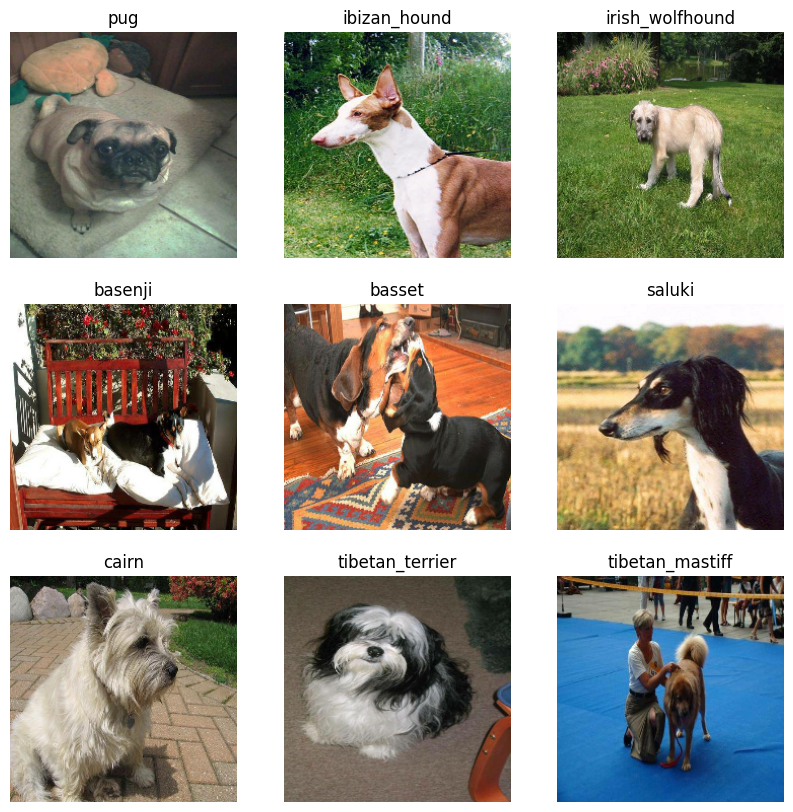

In [ ]:
show_images(train_images,train_labels)

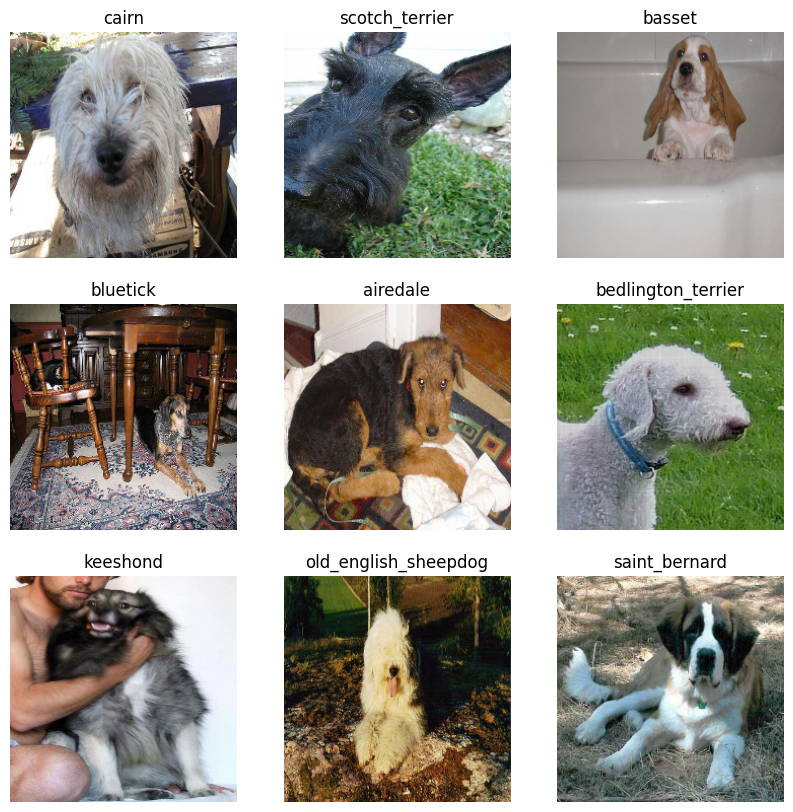

In [ ]:
valid_images, valid_labels = next(valid_data.as_numpy_iterator())
show_images(valid_images, valid_labels)

In [ ]:
INPUT_SHAPE = [None, IMG_SIZE, IMG_SIZE, 3] # batch, height, width, colour channels

OUTPUT_SHAPE = len(unique_breeds) 

# Setup model URL from TensorFlow Hub
MODEL_URL = "https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4"

In [ ]:
#Create a function which builds a Keras model
def create_model(input_shape = INPUT_SHAPE, output_shape = OUTPUT_SHAPE, model_url = MODEL_URL):
  print("Building model with ", MODEL_URL)

  #Create Model Layers
  model = tf.keras.Sequential([
      hub.KerasLayer(MODEL_URL), #Layer 1 
      tf.keras.layers.Dense(units = OUTPUT_SHAPE,
                            activation = "softmax") # Layer 2
  ])

  model.compile(
      loss = tf.keras.losses.CategoricalCrossentropy(),
      optimizer = tf.keras.optimizers.Adam(),
      metrics = ["accuracy"]
  )
  model.build(INPUT_SHAPE)

  return model
  

In [ ]:
model = create_model()
model.summary()

Building model with  https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer (KerasLayer)    (None, 1001)              5432713   
                                                                 
 dense (Dense)               (None, 120)               120240    
                                                                 
Total params: 5,552,953
Trainable params: 120,240
Non-trainable params: 5,432,713
_________________________________________________________________


### Callbacks


In [ ]:
import datetime

def create_tensorboard_callback():
  # Create a log directory for storing TensorBoard logs
  logdir = os.path.join("drive/My Drive/Dog-vision/logs",datetime.datetime.now().strftime("%Y%m%d"))
  return tf.keras.callbacks.TensorBoard(logdir)

In [ ]:
early_stopping = tf.keras.callbacks.EarlyStopping(monitor="val_accuracy", patience=3) # number of epochs with no improvement after which training will be stopped

### Training Model

In [ ]:
NUM_EPOCHS = 100 #@param {type:"slider", min:0, max:1000, step:10}

In [ ]:
def train_model():
  """
  Trains a given model and returns the trained version.
  """
  model = create_model()
  tensorboard = create_tensorboard_callback()
  
  model.fit(x=train_data,
            epochs=NUM_EPOCHS,
            validation_data=valid_data,
            validation_freq=1, # check validation metrics every epoch
            callbacks=[tensorboard, early_stopping])
  
  return model

In [ ]:
model = train_model() 

Building model with  https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4
Epoch 1/100
25/25 [==============================] - 170s 6s/step - loss: 4.4791 - accuracy: 0.1150 - val_loss: 3.4700 - val_accuracy: 0.1950
Epoch 2/100
25/25 [==============================] - 3s 119ms/step - loss: 1.6004 - accuracy: 0.7075 - val_loss: 2.2491 - val_accuracy: 0.4800
Epoch 3/100
25/25 [==============================] - 4s 144ms/step - loss: 0.5646 - accuracy: 0.9250 - val_loss: 1.7413 - val_accuracy: 0.5600
Epoch 4/100
25/25 [==============================] - 4s 158ms/step - loss: 0.2536 - accuracy: 0.9850 - val_loss: 1.5748 - val_accuracy: 0.5850
Epoch 5/100
25/25 [==============================] - 3s 118ms/step - loss: 0.1477 - accuracy: 1.0000 - val_loss: 1.4938 - val_accuracy: 0.6100
Epoch 6/100
25/25 [==============================] - 3s 118ms/step - loss: 0.1008 - accuracy: 1.0000 - val_loss: 1.4479 - val_accuracy: 0.6150
Epoch 7/100
25/25 [==============================]

In [ ]:
%load_ext tensorboard
%tensorboard --logdir drive/My\ Drive/Dog-vision/logs

<IPython.core.display.Javascript object>

In [ ]:
predictions = model.predict(valid_data, verbose=1)
predictions

7/7 [==============================] - 1s 93ms/step


array([[1.2981466e-03, 8.0356002e-04, 9.4142641e-05, ..., 3.0983487e-05,
        5.2136333e-05, 9.8069420e-04],
       [7.5161308e-03, 3.4772702e-03, 1.5936306e-02, ..., 3.6246667e-04,
        3.9794259e-03, 2.3976086e-04],
       [8.0774713e-05, 1.1261132e-03, 6.6925124e-05, ..., 1.4140775e-05,
        3.0263001e-04, 2.1264015e-04],
       ...,
       [2.6177711e-06, 4.7941721e-06, 4.9860511e-05, ..., 2.5971347e-06,
        7.6505552e-05, 2.3465898e-05],
       [4.4397744e-03, 3.8107531e-04, 2.6588415e-05, ..., 1.7569755e-04,
        4.6550864e-05, 9.3591316e-03],
       [4.8081551e-04, 9.1520660e-06, 1.9053445e-03, ..., 2.9412429e-03,
        1.7446075e-03, 2.6782311e-04]], dtype=float32)

In [ ]:
predictions.shape
#200 images 
#120 one for each unique dog breed

(200, 120)

In [ ]:
print(predictions[0])
print(f"Max value (probability of prediction): {np.max(predictions[0])}") 
print(f"Sum: {np.sum(predictions[0])}") 
print(f"Max index: {np.argmax(predictions[0])}") 
print(f"Predicted label: {unique_breeds[np.argmax(predictions[0])]}")

[1.29814656e-03 8.03560019e-04 9.41426406e-05 1.08967775e-04
 6.00222847e-04 3.81105201e-05 1.19371675e-02 1.79392810e-04
 1.33543799e-05 3.95228795e-04 2.13341249e-04 6.98158401e-05
 3.27524962e-04 9.00905434e-05 7.12778128e-05 5.64945862e-04
 9.31781542e-05 2.44000509e-01 3.67349676e-05 1.43115016e-04
 5.76706778e-04 1.97113535e-04 1.11243417e-05 1.08087924e-03
 1.10554436e-04 1.02151702e-04 2.25750431e-02 1.78585586e-04
 2.90037831e-04 2.47486314e-04 4.31673798e-05 1.21850718e-03
 9.40996470e-05 2.83700738e-05 1.52595370e-04 3.58163775e-03
 1.79016897e-05 4.15761024e-04 8.06378957e-05 1.52377761e-05
 5.41302667e-04 1.12232292e-05 2.90921249e-04 7.09238986e-04
 2.90504395e-05 1.25937443e-03 2.30707556e-05 6.72259994e-05
 3.87281209e-04 5.14341191e-05 8.03793082e-05 5.91029420e-05
 1.33015608e-04 5.88784169e-05 1.16581105e-04 3.46875859e-05
 3.04387504e-04 2.83001550e-03 2.12321625e-04 2.97742039e-01
 2.13093575e-04 2.74127365e-06 1.39383494e-03 4.69498882e-05
 4.46032645e-04 9.206792

In [ ]:
def get_class_name(prediction_probabilities):
  #Returns highest probability class name
  return unique_breeds[np.argmax(prediction_probabilities)]

prediction_labels = get_class_name(predictions[0])
prediction_labels

'irish_wolfhound'

In [ ]:
def unbatchify(data):
  """
  Since our validation data is in batch form, 
  to get a list of validation images and labels, 
  """
  images = []
  labels = []
  for image, label in data.unbatch().as_numpy_iterator():
    images.append(image)
    labels.append(unique_breeds[np.argmax(label)])
  return images, labels

valid_images, valid_labels = unbatchify(valid_data)
valid_images[0], valid_labels[0]

(array([[[0.29599646, 0.43284872, 0.3056691 ],
         [0.26635826, 0.32996926, 0.22846507],
         [0.31428418, 0.27701408, 0.22934894],
         ...,
         [0.77614343, 0.82320225, 0.8101595 ],
         [0.81291157, 0.8285351 , 0.8406944 ],
         [0.8209297 , 0.8263737 , 0.8423668 ]],
 
        [[0.2344871 , 0.31603682, 0.19543913],
         [0.3414841 , 0.36560842, 0.27241898],
         [0.45016077, 0.40117094, 0.33964607],
         ...,
         [0.7663987 , 0.8134138 , 0.81350833],
         [0.7304248 , 0.75012016, 0.76590735],
         [0.74518913, 0.76002574, 0.7830809 ]],
 
        [[0.30157745, 0.3082587 , 0.21018331],
         [0.2905954 , 0.27066195, 0.18401104],
         [0.4138316 , 0.36170745, 0.2964005 ],
         ...,
         [0.79871625, 0.8418535 , 0.8606443 ],
         [0.7957738 , 0.82859945, 0.8605655 ],
         [0.75181633, 0.77904975, 0.8155256 ]],
 
        ...,
 
        [[0.9746779 , 0.9878955 , 0.9342279 ],
         [0.99153054, 0.99772066, 0.94278

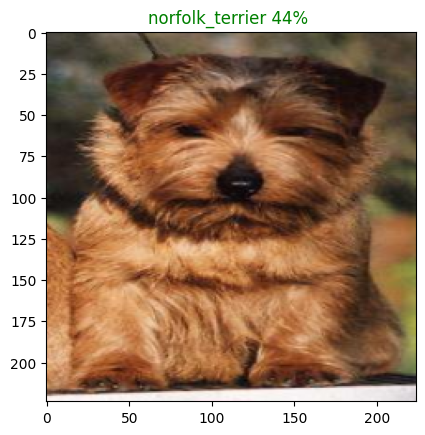

In [ ]:
def plot_pred(prediction_probabilities, labels, images, n=52):
  """
  View the prediction, ground truth label and image for sample n.
  """
  pred_prob, true_label, image = prediction_probabilities[n], labels[n], images[n]
  prediction_label = get_class_name(pred_prob)
  
  plt.imshow(image)

  if prediction_label == true_label:
    color = "green"
  else:
    color = "red"

  plt.title("{} {:2.0f}% ".format(prediction_label,
                                  np.max(pred_prob)*100),
                                  color=color)
  
plot_pred(prediction_probabilities=predictions,
          labels=valid_labels,
          images=valid_images)

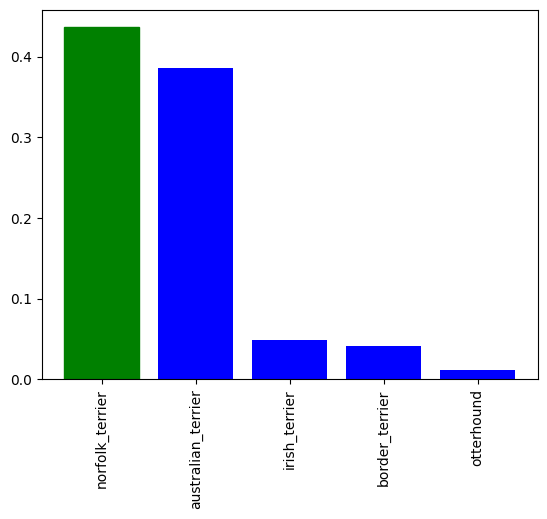

In [ ]:
def plot_prediction_conf(prediction_probabilities, labels, n=52):

  pred_prob, true_label = prediction_probabilities[n], labels[n]
  pred_label = get_class_name(pred_prob)

  # Find the top 10 prediction confidence indexes
  top_10_pred_indexes = pred_prob.argsort()[-5:][::-1]
  top_10_pred_values = pred_prob[top_10_pred_indexes]
  top_10_prediction_labels = unique_breeds[top_10_pred_indexes]

  top_plot = plt.bar(np.arange(len(top_10_prediction_labels)), 
                     top_10_pred_values, 
                     color="blue")
  plt.xticks(np.arange(len(top_10_prediction_labels)),
             labels=top_10_prediction_labels,
             rotation="vertical")

  # Change color of true label
  if np.isin(true_label, top_10_prediction_labels):
    top_plot[np.argmax(top_10_prediction_labels == true_label)].set_color("green")
  else:
    pass

plot_prediction_conf(prediction_probabilities=predictions,
               labels=valid_labels,
               n=52)

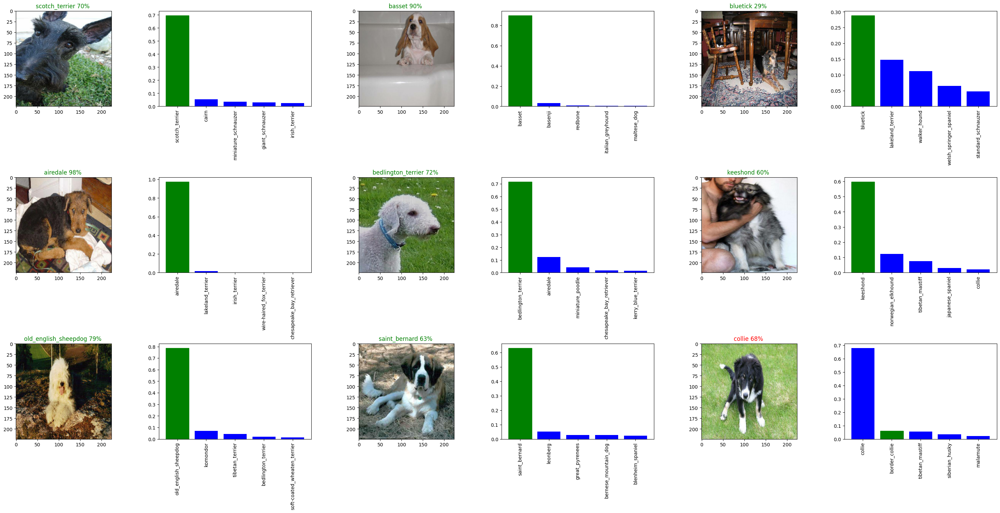

In [ ]:
selective = 1
num_rows = 3
num_cols = 3
num_images = num_rows*num_cols
plt.figure(figsize=(5*2*num_cols, 5*num_rows))
for i in range(num_images):
  plt.subplot(num_rows, 2*num_cols, 2*i+1)
  plot_pred(prediction_probabilities=predictions,
            labels=valid_labels,
            images=valid_images,
            n=i+selective)
  plt.subplot(num_rows, 2*num_cols, 2*i+2)
  plot_prediction_conf(prediction_probabilities=predictions,
                labels=valid_labels,
                n=i+selective)
plt.tight_layout(h_pad=1.0)
plt.show()

### Save and Load Model

In [ ]:
def save_model(model, suffix=None):

  modeldir = os.path.join("drive/My Drive/Dog-vision/models", datetime.datetime.now().strftime("%Y%m%d"))
  model_path = modeldir + "-" + suffix + ".h5" 
  print(f"Saving model to: {model_path}...")
  model.save(model_path)
  print(f"Saved model..")
  return model_path

In [ ]:
def load_model(model_path):

  print(f"Loading saved model from: {model_path}")
  model = tf.keras.models.load_model(model_path,
                                     custom_objects={"KerasLayer":hub.KerasLayer})
  return model

In [ ]:
save_model(model, suffix="1000img_V1_OT")

Saving model to: drive/My Drive/Dog-vision/models/20230403-1000img_V1_OT.h5...
Saved model..


'drive/My Drive/Dog-vision/models/20230403-1000img_V1_OT.h5'

In [ ]:
model_beta = load_model('drive/My Drive/Dog-vision/models/20230402-14181680445081-1000img_V1_OT.h5')

Loading saved model from: drive/My Drive/Dog-vision/models/20230402-14181680445081-1000img_V1_OT.h5


In [ ]:
model_beta.evaluate(valid_data)

7/7 [==============================] - 1s 77ms/step - loss: 1.2802 - accuracy: 0.6900


[1.2802256345748901, 0.6899999976158142]

###Training a model (on the full data)


In [ ]:
full_data = create_data_batches(X, y)
full_model = create_model()


Creating train batches..
Building model with  https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4


In [ ]:
full_model_tensorboard = create_tensorboard_callback()
full_model_early_stopping = tf.keras.callbacks.EarlyStopping(monitor="accuracy",
                                                             patience=3)

In [ ]:
%tensorboard --logdir drive/My\ Drive/Dog-vision/logs

Reusing TensorBoard on port 6006 (pid 10879), started 0:00:13 ago. (Use '!kill 10879' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
full_model.fit(x=full_data,
               epochs=NUM_EPOCHS,
               callbacks=[full_model_tensorboard, 
                          full_model_early_stopping])

Epoch 1/100
320/320 [==============================] - 39s 108ms/step - loss: 1.3468 - accuracy: 0.6708
Epoch 2/100
320/320 [==============================] - 33s 102ms/step - loss: 0.4045 - accuracy: 0.8814
Epoch 3/100
320/320 [==============================] - 34s 106ms/step - loss: 0.2381 - accuracy: 0.9377
Epoch 4/100
320/320 [==============================] - 34s 105ms/step - loss: 0.1545 - accuracy: 0.9639
Epoch 5/100
320/320 [==============================] - 33s 103ms/step - loss: 0.1075 - accuracy: 0.9775
Epoch 6/100
320/320 [==============================] - 33s 102ms/step - loss: 0.0777 - accuracy: 0.9863
Epoch 7/100
320/320 [==============================] - 32s 101ms/step - loss: 0.0614 - accuracy: 0.9896
Epoch 8/100
320/320 [==============================] - 32s 101ms/step - loss: 0.0466 - accuracy: 0.9942
Epoch 9/100
320/320 [==============================] - 33s 102ms/step - loss: 0.0361 - accuracy: 0.9965
Epoch 10/100
320/320 [==============================] - 33s 102m

In [ ]:
save_model(full_model, suffix="fullmodel_V1_OT")

Saving model to: drive/My Drive/Dog-vision/models/20230403-fullmodel_V1_OT.h5...
Saved model..


'drive/My Drive/Dog-vision/models/20230403-fullmodel_V1_OT.h5'

In [ ]:
model_v1 = load_model('drive/My Drive/Dog-vision/models/20230403-fullmodel_V1_OT.h5')

Loading saved model from: drive/My Drive/Dog-vision/models/20230403-fullmodel_V1_OT.h5


In [ ]:
test_path = "drive/My Drive/Dog-vision/test/"
test_filenames = [test_path + fname for fname in os.listdir(test_path)]
test_filenames[:10]

['drive/My Drive/Dog-vision/test/de291f05facd9c7db8d4880a0c84263b.jpg',
 'drive/My Drive/Dog-vision/test/dccf2e91f79396055e7ff83f1f207fbc.jpg',
 'drive/My Drive/Dog-vision/test/e78d3997b4e7f4abc1299f81b8e3b2d9.jpg',
 'drive/My Drive/Dog-vision/test/e14211c7b8cba3e46d5802291b765be7.jpg',
 'drive/My Drive/Dog-vision/test/e3dd8fc9162f726122ca4cc783114c81.jpg',
 'drive/My Drive/Dog-vision/test/e7a1b7a42db97df750aeae212a02d9c4.jpg',
 'drive/My Drive/Dog-vision/test/dfc41d3f135d49a41e7b796883ff030e.jpg',
 'drive/My Drive/Dog-vision/test/e60df508ef9f70f9c556003827827234.jpg',
 'drive/My Drive/Dog-vision/test/e298c484aa05012775db02f3596e1d18.jpg',
 'drive/My Drive/Dog-vision/test/e288dace85bb7ae95b545066bcbdee60.jpg']

In [ ]:
test_data = create_data_batches(test_filenames, test_data=True)

Creating test batches..


In [ ]:
test_predictions = model_v1.predict(test_data,verbose=1)

324/324 [==============================] - 184s 544ms/step


In [ ]:
prediction_df = pd.DataFrame(columns=["id"] + list(unique_breeds))

In [ ]:
prediction_df.to_csv("drive/My Drive/Dog-vision/mobilienetV2_final.csv", index=False)